# Hacklytics - SCLUVID (Semantic CLUstering of CoVID)

## GOAL

Given the volume of literature and the rapid transmission of COVID-19 during the earlier days, it was challenging for health experts to stay up to date on new information about the virus.

Can grouping similar research articles together make it easier to find related publications?
How may the cluster content be qualified?


A scatter plot can be used to represent a collection of literature by categorising it with clustering and visualising it with the help of dimensionality reduction.

Publications with extremely comparable topics will be labelled and plotted near one other on this plot.
Topic modelling will be used to determine the keywords of each cluster in order to find significance in the clusters. 

In [5]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import glob
import json
import random

random.seed(1234)

import matplotlib.pyplot as plt
plt.style.use('ggplot')

root_path = '/kaggle/input/CORD-19-research-challenge/'
metadata_path = f'{root_path}/metadata.csv'
meta_df = pd.read_csv(metadata_path, dtype={
    'pubmed_id': str,
    'Microsoft Academic Paper ID': str, 
    'doi': str
})
meta_df.head()

/opt/conda/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3552: DtypeWarning: Columns (1,5,13,14,15,16) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract,publish_time,authors,journal,mag_id,who_covidence_id,arxiv_id,pdf_json_files,pmc_json_files,url,s2_id
0,ug7v899j,d1aafb70c066a2068b02786f8929fd9c900897fb,PMC,Clinical features of culture-proven Mycoplasma...,10.1186/1471-2334-1-6,PMC35282,11472636,no-cc,OBJECTIVE: This retrospective chart review des...,2001-07-04,"Madani, Tariq A; Al-Ghamdi, Aisha A",BMC Infect Dis,NaN,NaN,NaN,document_parses/pdf_json/d1aafb70c066a2068b027...,document_parses/pmc_json/PMC35282.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3...,NaN
1,02tnwd4m,6b0567729c2143a66d737eb0a2f63f2dce2e5a7d,PMC,Nitric oxide: a pro-inflammatory mediator in l...,10.1186/rr14,PMC59543,11667967,no-cc,Inflammatory diseases of the respiratory tract...,2000-08-15,"Vliet, Albert van der; Eiserich, Jason P; Cros...",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/6b0567729c2143a66d737...,document_parses/pmc_json/PMC59543.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
2,ejv2xln0,06ced00a5fc04215949aa72528f2eeaae1d58927,PMC,Surfactant protein-D and pulmonary host defense,10.1186/rr19,PMC59549,11667972,no-cc,Surfactant protein-D (SP-D) participates in th...,2000-08-25,"Crouch, Erika C",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/06ced00a5fc04215949aa...,document_parses/pmc_json/PMC59549.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
3,2b73a28n,348055649b6b8cf2b9a376498df9bf41f7123605,PMC,Role of endothelin-1 in lung disease,10.1186/rr44,PMC59574,11686871,no-cc,Endothelin-1 (ET-1) is a 21 amino acid peptide...,2001-02-22,"Fagan, Karen A; McMurtry, Ivan F; Rodman, David M",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/348055649b6b8cf2b9a37...,document_parses/pmc_json/PMC59574.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN
4,9785vg6d,5f48792a5fa08bed9f56016f4981ae2ca6031b32,PMC,Gene expression in epithelial cells in respons...,10.1186/rr61,PMC59580,11686888,no-cc,Respiratory syncytial virus (RSV) and pneumoni...,2001-05-11,"Domachowske, Joseph B; Bonville, Cynthia A; Ro...",Respir Res,NaN,NaN,NaN,document_parses/pdf_json/5f48792a5fa08bed9f560...,document_parses/pmc_json/PMC59580.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5...,NaN


In [6]:
meta_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1056660 entries, 0 to 1056659
Data columns (total 19 columns):
 #   Column            Non-Null Count    Dtype  
---  ------            --------------    -----  
 0   cord_uid          1056660 non-null  object 
 1   sha               373766 non-null   object 
 2   source_x          1056660 non-null  object 
 3   title             1056157 non-null  object 
 4   doi               656780 non-null   object 
 5   pmcid             389571 non-null   object 
 6   pubmed_id         498932 non-null   object 
 7   license           1056660 non-null  object 
 8   abstract          821118 non-null   object 
 9   publish_time      1054846 non-null  object 
 10  authors           1032791 non-null  object 
 11  journal           969338 non-null   object 
 12  mag_id            0 non-null        float64
 13  who_covidence_id  482935 non-null   object 
 14  arxiv_id          14249 non-null    object 
 15  pdf_json_files    373766 non-null   object 
 16  

APPROACH:
1. Focus on title or abstract or combination of title and abstract.
2. Eliminate obvious phrases like COVID, SARS to highlight importance of other relevant terms
3. Perform sentence vectorization using sentence transformers from Huggingface
4. Apply Dimensionality Reduction to each feature vector using UMAP - iterated over a range of values for some important parameters to get better result
5. Apply mini batch k-means clustering on fitted result of UMAP and ran it across a range of k values to determine the best possible cluster limit using Silhouette Score.
6. Apply Topic Modeling on best set of params of UMAP and Kmeans using BERTopic to discover keywords from each cluster.
7. Investigate the clusters visually on the plot.

In [7]:
!pip install langdetect
!pip install sentence-transformers
!pip install bertopic

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 981.5/981.5 kB 1.1 MB/s eta 0:00:0000:0100:01
  Preparing metadata (setup.py) ... done
  Created wheel for langdetect: filename=langdetect-1.0.9-py3-none-any.whl size=993242 sha256=fefaf484cfb66f56ac17c37fa4a8763619059b731a8e730cb52923830a835d22
  Stored in directory: /root/.cache/pip/wheels/c5/96/8a/f90c59ed25d75e50a8c10a1b1c2d4c402e4dacfa87f3aff36a
Successfully built langdetect
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.0/86.0 kB 305.2 kB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
  Created wheel for sentence-transformers: filename=sentence_transformers-2.2.2-py3-none-any.whl size=125938 sha256=87ebee0c343e5759365f62a281d3464f1855c8a63c5b16c1b6a5ac87db05ea18
  Stored in directory: /root/.cache/pip/wheels/bf/06/fb/d59c1e5bd1dac7f6cf61ec0036cc3a10ab8fecaa6b2c3d3ee9
Successfully built sentence-transformers
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.9/103.9 kB 321.5 kB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━

In [8]:
from langdetect import detect
from tqdm import tqdm
tqdm.pandas()


df_covid = meta_df.sample(20_000)
df_covid.dropna(subset=['abstract'], inplace=True)

# hold label - language
languages = []

# go through each text
for ii in tqdm(range(0,len(df_covid))):
    # split by space into list, take the first x intex, join with space
    text = df_covid.iloc[ii]['abstract']
    text = text.split(' ')
    
    lang = "en"
    try:
        if len(text) > 50:
            lang = detect(" ".join(text[:50]))
        elif len(text) > 0:
            lang = detect(" ".join(text[:len(text)]))
            
    except Exception as e:
        all_words = set(text)
        try:
            lang = detect(" ".join(all_words))
        except Exception as e:
            try:
                # let's try to label it through the abstract then
                lang = detect(df.iloc[ii]['abstract'])
            except Exception as e:
                lang = "unknown"
                pass
    
    # get the language
    languages.append(lang)

100%|██████████| 15536/15536 [01:21<00:00, 189.65it/s]


In [71]:
df_covid['lang'] = languages
df = df_covid[df_covid['lang'] == 'en']
df.shape

(15279, 20)

In [72]:
df.to_csv('/kaggle/working/df_covid.csv', index=False)


In [84]:
df_final=pd.read_csv('/kaggle/working/df_covid.csv')

In [11]:
from sentence_transformers import SentenceTransformer
model = SentenceTransformer('all-MiniLM-L6-v2')

Downloading:   0%|          | 0.00/1.18k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/10.6k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/612 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/116 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/39.3k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/350 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/13.2k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/349 [00:00<?, ?B/s]

In [75]:
df_final

,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract,publish_time,authors,journal,mag_id,who_covidence_id,arxiv_id,pdf_json_files,pmc_json_files,url,s2_id,lang
0,qz8t2ip4,NaN,WHO,‘different than a Regular White’: Exploring He...,10.1017/s1742058x21000333,NaN,NaN,unk,Qualitative research can clarify how the racia...,2022,"Efird, Caroline R.",Du Bois Review,NaN,#covidwho-1773885,NaN,NaN,NaN,https://doi.org/10.1017/s1742058x21000333,240522337.0,en
1,r4e4tg7r,5f56384f94fb45e0116ab992e73e1fb5b5c27693,Elsevier; Medline; PMC,Prevalence and severity of corona virus diseas...,10.1016/j.jcv.2020.104371,PMC7195434,32315817,els-covid,Abstract Background Since being first reported...,2020-06-30,"Hu, Yong; Sun, Jiazhong; Dai, Zhe; Deng, Haohu...",Journal of Clinical Virology,NaN,NaN,NaN,document_parses/pdf_json/5f56384f94fb45e0116ab...,document_parses/pmc_json/PMC7195434.xml.json,https://api.elsevier.com/content/article/pii/S...,216075678.0,en
2,8air35yx,a7e92e8576719f541433484013b116124f386fe6,Medline; PMC; WHO,The Humanoid Robot Sil-Bot in a Cognitive Trai...,10.3390/ijerph18158198,PMC8345968,34360490,cc-by,Background: Mild cognitive impairment (MCI) is...,2021-08-03,"Park, Eun-A; Jung, Ae-Ri; Lee, Kyoung-A",Int J Environ Res Public Health,NaN,NaN,NaN,document_parses/pdf_json/a7e92e8576719f5414334...,document_parses/pmc_json/PMC8345968.xml.json,https://www.ncbi.nlm.nih.gov/pubmed/34360490/;...,236944663.0,en
3,rf0tl4we,0cd2cad717a8e8d0dff547735baa0d04e4406a05,Elsevier; Medline; PMC,Evaluation of four commercial severe acute res...,10.1016/j.jiac.2021.03.008,PMC7959261,33781691,els-covid,Introduction Numerous severe acute respiratory...,2021-03-15,"Ashizawa, Nobuyuki; Takazono, Takahiro; Ohyama...",J Infect Chemother,NaN,NaN,NaN,document_parses/pdf_json/0cd2cad717a8e8d0dff54...,NaN,https://api.elsevier.com/content/article/pii/S...,232234066.0,en
4,n6qmxavc,NaN,Medline; WHO,Can inpatient pharmacists move the needle on s...,10.1093/ajhp/zxab488,NaN,34951621,unk,DISCLAIMER In an effort to expedite the public...,2021-12-24,"Creswell, Paul D; McCarthy, Danielle E; Trapsk...",American journal of health-system pharmacy : A...,NaN,NaN,NaN,NaN,NaN,https://www.ncbi.nlm.nih.gov/pubmed/34951621/;...,245489491.0,en
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15274,6hbh5ulh,NaN,Medline,Endoscopic Fenestration of Arachnoid cysts Thr...,10.1016/j.wneu.2020.12.108,NaN,33385600,unk,BACKGROUND The ideal treatment method for cran...,2020-12-29,"El Refaee, Ehab; Elbaroody, Mohammad",World neurosurgery,NaN,NaN,NaN,NaN,NaN,https://doi.org/10.1016/j.wneu.2020.12.108; ht...,230107039.0,en
15275,71qya34t,447d7f4d6e122d277d1ec819d357a484eb3e555c,Medline; PMC,Video Visits Using the Zoom for Healthcare Pla...,10.1177/20543581211008698,PMC8082995,33996106,cc-by,BACKGROUND: Demand for virtual visits (an onli...,2021-04-26,"Lunney, Meaghan; Thomas, Chandra; Rabi, Doreen...",Can J Kidney Health Dis,NaN,NaN,NaN,document_parses/pdf_json/447d7f4d6e122d277d1ec...,document_parses/pmc_json/PMC8082995.xml.json,https://www.ncbi.nlm.nih.gov/pubmed/33996106/;...,234494323.0,en
15276,7dc3h1ix,NaN,WHO,Drug and Vaccine Design against Novel Coronavi...,10.20944/preprints202002.0071.v1,NaN,NaN,cc-by,The recent outbreak of the new virus in Wuhan ...,2020,"Kumar, Suresh",NaN,NaN,#ppcovidwho-314680,NaN,NaN,NaN,https://doi.org/10.20944/preprints202002.0071.v1,213431165.0,en
15277,rzcdgis3,9abf161e94acd8ee9cbfe865a93f0a3512963e7b,Medline; PMC,A Head‐to‐Head Comparison of a Free Fatty Acid...,10.1161/jaha.121.024176,PMC9075326,35232215,cc-by-nc-nd,BACKGROUND: MAT9001 is an omega‐3 free fatty a...,2022-03-01,"Maki, Kevin C.; Bays, Harold E.; Ballantyne, C...",J Am Heart Assoc,NaN,NaN,NaN,document_parses/pdf_json/9abf161e94acd8ee9cbfe...,document_parses/pmc_json/PMC9075326.xml.json,https://doi.org/10.1161/jaha.121.024176; https...,247190927.0,en


In [85]:
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords

stop_words = set(stopwords.words("english"))

def remove_stopwords(text):
    words = text.split()
    words_without_stopwords = [word for word in words if not word in stop_words]
    return " ".join(words_without_stopwords)

[nltk_data] Downloading package stopwords to /usr/share/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [87]:
df_final['title']=df_final['title'].astype(str)

In [98]:
df_final['processed_abstract'] = df_final['abstract'].apply(remove_stopwords)

In [105]:
df_final['title_updated'] = df_final['title'].progress_apply(lambda x: re.sub('[Cc]ovid|COVID|sars|SARS|[Pp]andemic|CoV|19','',x, re.IGNORECASE))
df_final['abstract_updated'] = df_final['processed_abstract'].progress_apply(lambda x: re.sub('[Cc]ovid|COVID|sars|SARS|[Pp]andemic|CoV|19','',x, re.IGNORECASE))
df_final['concated'] =  df_final['title_updated'] + df_final['abstract_updated']

100%|██████████| 15279/15279 [00:00<00:00, 47700.47it/s]


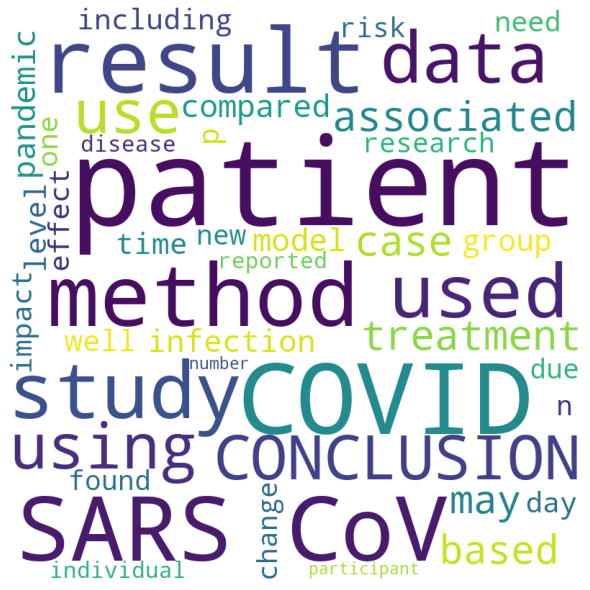

In [31]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

sentences = list(df_final['concated'])

stopwords = set(STOPWORDS)
comment_words = ''
# iterate through the csv file
for val in sentences:
    # split the value
    tokens = val.split()
     
    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i]
     
    comment_words += " ".join(tokens)+" "

    
wordcloud = WordCloud(width = 800, height = 800,
                      background_color ='white',
                      stopwords = stopwords,
                      max_words=50,
                      min_font_size = 10).generate(comment_words)
 
# plot the WordCloud image                      
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.show()

In [32]:
from umap import UMAP
from sklearn.cluster import MiniBatchKMeans
from sklearn.metrics import silhouette_score
from tqdm import tqdm

In [106]:
sentences = list(df_final['concated'])
embeddings = model.encode(sentences, show_progress_bar=True)

Batches:   0%|          | 0/478 [00:00<?, ?it/s]

In [79]:
best_params = []

for neigh in [10, 25, 50]:
    for comp in [10, 25, 50]:
        print(f'comp: {comp} -- neigh: {neigh}')
        fit = UMAP(
            n_neighbors=neigh,
            n_components=comp,
            metric='euclidean',
            min_dist=0.05
        )
        X = fit.fit_transform(embeddings)
        
        silh_scores = {}
        for clus in tqdm(range(5, 30)):
            kmeans_model = MiniBatchKMeans(n_clusters=clus, 
                                           random_state=369).fit(X)
            labels = kmeans_model.labels_
            silh_scores[clus] = silhouette_score(X, labels, metric='euclidean')
            
        best_silh_k = max(silh_scores, key= lambda x: silh_scores[x])
        
        best_params.append({'comp': comp, 'neigh': neigh, 'best_k': best_silh_k, 'silh_score': silh_scores[best_silh_k]})

Batches:   0%|          | 0/478 [00:00<?, ?it/s]

comp: 10 -- neigh: 10


100%|██████████| 25/25 [01:47<00:00,  4.31s/it]


comp: 25 -- neigh: 10


100%|██████████| 25/25 [01:47<00:00,  4.32s/it]


comp: 50 -- neigh: 10


100%|██████████| 25/25 [01:51<00:00,  4.47s/it]


comp: 10 -- neigh: 25


100%|██████████| 25/25 [01:44<00:00,  4.17s/it]


comp: 25 -- neigh: 25


100%|██████████| 25/25 [01:45<00:00,  4.21s/it]


comp: 50 -- neigh: 25


100%|██████████| 25/25 [01:48<00:00,  4.36s/it]


comp: 10 -- neigh: 50


100%|██████████| 25/25 [01:43<00:00,  4.14s/it]


comp: 25 -- neigh: 50


100%|██████████| 25/25 [01:45<00:00,  4.22s/it]


comp: 50 -- neigh: 50


100%|██████████| 25/25 [01:54<00:00,  4.56s/it]


In [80]:
best_params

[{'comp': 10, 'neigh': 10, 'best_k': 29, 'silh_score': 0.34018946},
 {'comp': 25, 'neigh': 10, 'best_k': 26, 'silh_score': 0.33371538},
 {'comp': 50, 'neigh': 10, 'best_k': 27, 'silh_score': 0.34273407},
 {'comp': 10, 'neigh': 25, 'best_k': 5, 'silh_score': 0.32764068},
 {'comp': 25, 'neigh': 25, 'best_k': 5, 'silh_score': 0.3325914},
 {'comp': 50, 'neigh': 25, 'best_k': 28, 'silh_score': 0.32483706},
 {'comp': 10, 'neigh': 50, 'best_k': 5, 'silh_score': 0.32169896},
 {'comp': 25, 'neigh': 50, 'best_k': 5, 'silh_score': 0.31581688},
 {'comp': 50, 'neigh': 50, 'best_k': 27, 'silh_score': 0.31834644}]

In [81]:
k = 27
fit = UMAP(
    n_neighbors=10,
    n_components=50,
    metric='euclidean',
    min_dist=0.05
)
X = fit.fit_transform(embeddings)
kmeans_model = MiniBatchKMeans(n_clusters=k, random_state=369).fit(X)
y_pred = kmeans_model.fit_predict(X)

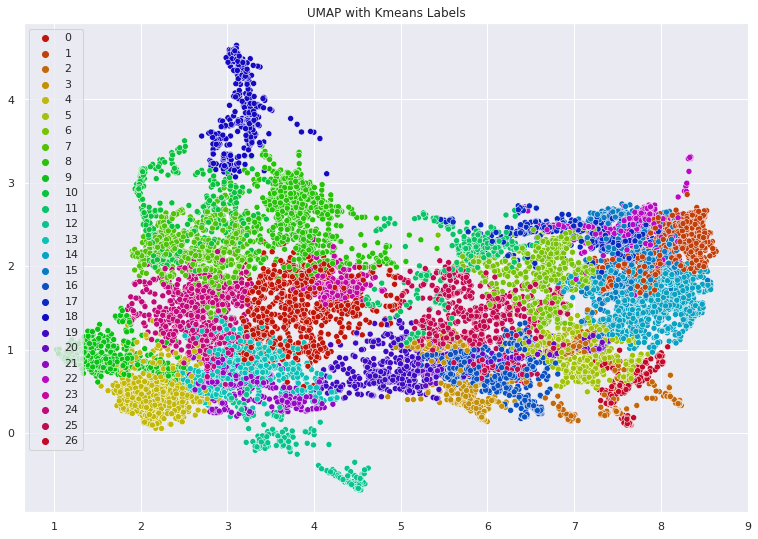

In [82]:
%matplotlib inline
from matplotlib import pyplot as plt
import seaborn as sns

# sns settings
sns.set(rc={'figure.figsize':(13,9)})

# colors
palette = sns.hls_palette(k, l=.4, s=.9)

# plot
sns.scatterplot(X[:,0], X[:,1], hue=y_pred, legend='full', palette=palette)
plt.title('UMAP with Kmeans Labels')
plt.show()

In [45]:
!pip install bertopic

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [107]:
from bertopic import BERTopic

topic_model = BERTopic(embedding_model=model, 
                      umap_model=UMAP(
                            n_neighbors=10,
                            n_components=50,
                            metric='euclidean',
                            min_dist=0.05
                      ),
                      hdbscan_model=MiniBatchKMeans(n_clusters=k, random_state=369),
                      diversity=0.5,
                      verbose=True).fit(sentences, embeddings)

2023-02-12 13:55:17,923 - BERTopic - Reduced dimensionality
2023-02-12 13:55:18,132 - BERTopic - Clustered reduced embeddings


In [108]:
topic_model.visualize_barchart(top_n_topics=-1)

In [109]:
topic_model.visualize_documents(sentences, embeddings=embeddings)

In [110]:
topic_model.visualize_heatmap()